<a href="https://colab.research.google.com/github/matheusbarroso/airbnb_rj/blob/main/airbnb_rj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install geopandas

In [ ]:
! pip install scikit-learn --upgrade 

Requirement already up-to-date: scikit-learn in /usr/local/lib/python3.6/dist-packages (0.24.1)


In [443]:
import os
import datetime as dt
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import nltk

import geopandas as gpd
import folium

from itertools import chain
from folium import plugins
from branca.colormap import linear, LinearColormap
from statsmodels.formula.api import ols
from IPython.display import Markdown, IFrame
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from matplotlib.colors import rgb2hex

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import GammaRegressor
from sklearn.metrics import mean_squared_error, mean_gamma_deviance, mean_absolute_percentage_error
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler

from lightgbm import LGBMRegressor

from scipy.stats import expon

In [ ]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

Global variables and configuration options:

In [ ]:
pd.set_option('display.max_rows', 100)
sns.set_theme(color_codes=True)

# Introduction
In this notebook I'll be analysing the [airbnb](http://insideairbnb.com/get-the-data.html) dataset for Rio de Janeiro Listings

In [ ]:
Markdown("""
All related datasets available at **{}** were downloaded 
""".format(dt.datetime.now().strftime('%Y-%m-%d %H:%M:%S')))


All related datasets available at **2021-01-22 22:38:20** were downloaded 


We can consider that the data has five dimensions:
1. listings: a cross section of listing main information (detailed)
2. calendar: time series of listing prices
3. reviews: detailed reviews data
4. neighbourhoods: Neighbourhood list for geo filter
5. neighbourhoods.geojson: GeoJSON file of neighbourhoods of the city

The outline of this analysis will be to first read the dataset and perform some minor analysis, second, by a more detailed exploratory data analysis, third, price modelling, fourth, the modelling diagnosis and finally some final thoughs.

## Before moving forward we will define some utility functions:

In [ ]:
def na_diag(df):
    return (
        df.isna()
          .sum()
          .div(df.shape[0])
          .sort_values(ascending=False)
          .rename('MissingFraction')
          .to_frame()
          .style
          .format('{:,.2%}')
          .background_gradient(cmap=cm)
    )

# Reading the Datasets

## Listings

First, we will be downloading the listings dataset:

In [ ]:
listings = pd.read_csv('http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2020-12-23/data/listings.csv.gz')

In [ ]:
listings.head(2)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,17878,https://www.airbnb.com/rooms/17878,20201223235510,2020-12-30,"Very Nice 2Br in Copacabana w. balcony, fast WiFi",Discounts for long term stays. <br />- Large b...,This is the one of the bests spots in Rio. Bec...,https://a0.muscache.com/pictures/65320518/3069...,68997,https://www.airbnb.com/users/show/68997,Matthias,2010-01-08,"Rio de Janeiro, State of Rio de Janeiro, Brazil",I am a journalist/writer. Lived for 15 years...,within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/67b13...,https://a0.muscache.com/im/pictures/user/67b13...,Copacabana,2.0,2.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"Rio de Janeiro, Brazil",Copacabana,NaN,-22.96592,-43.17896,Entire condominium,Entire home/apt,5,NaN,1 bath,2.0,2.0,"[""Hot water"", ""Essentials"", ""Stove"", ""Microwav...",$500.00,5,180,5,5,1125,1125,5.0,1125.0,NaN,t,0,0,0,0,2020-12-30,259,13,2,2010-07-15,2020-12-26,93.0,9.0,9.0,10.0,10.0,10.0,9.0,NaN,t,1,1,0,0,2.03
1,25026,https://www.airbnb.com/rooms/25026,20201223235510,2020-12-24,Beautiful Modern Decorated Studio in Copa,"Our apartment is a little gem, everyone loves ...",Copacabana is a lively neighborhood and the ap...,https://a0.muscache.com/pictures/3003965/68ebb...,3746246,https://www.airbnb.com/users/show/3746246,Ghizlane,2012-10-03,"Rio de Janeiro, Rio de Janeiro, Brazil","French girl ""lost in Brazilian translation"" si...",within a day,89%,71%,f,https://a0.muscache.com/im/pictures/user/fffed...,https://a0.muscache.com/im/pictures/user/fffed...,Ipanema,11.0,11.0,"['phone', 'reviews', 'jumio', 'offline_governm...",t,f,"Rio de Janeiro, Brazil",Copacabana,NaN,-22.97712,-43.19045,Entire apartment,Entire home/apt,2,NaN,1 bath,1.0,2.0,"[""TV"", ""Cable TV"", ""Elevator"", ""Essentials"", ""...",$160.00,7,60,7,7,60,60,7.0,60.0,NaN,t,7,30,60,335,2020-12-24,238,2,0,2010-06-07,2020-02-15,94.0,9.0,9.0,9.0,10.0,10.0,9.0,NaN,f,11,11,0,0,1.85


In [ ]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25784 entries, 0 to 25783
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            25784 non-null  int64  
 1   listing_url                                   25784 non-null  object 
 2   scrape_id                                     25784 non-null  int64  
 3   last_scraped                                  25784 non-null  object 
 4   name                                          25755 non-null  object 
 5   description                                   24423 non-null  object 
 6   neighborhood_overview                         14109 non-null  object 
 7   picture_url                                   25784 non-null  object 
 8   host_id                                       25784 non-null  int64  
 9   host_url                                      25784 non-null 

In [ ]:
cm = sns.light_palette("green", as_cmap=True)

Secondly, we can retrive some basic data quality measures such as the columns with higher missing fractions. That is $\frac{\#\_missing\_values\_in\_column\_ X}{\#\_rows\_in\_the\_dataset}$

In [ ]:
listings.pipe(na_diag)

,MissingFraction
bathrooms,100.00%
calendar_updated,100.00%
neighbourhood_group_cleansed,100.00%
license,100.00%
host_about,50.52%
neighborhood_overview,45.28%
neighbourhood,45.28%
host_neighbourhood,41.60%
review_scores_accuracy,40.71%
review_scores_checkin,40.70%


In [ ]:
(listings.isna()
         .sum()
         .div(listings.shape[0])
         .sort_values(ascending=False)
         .rename('MissingFraction')
         .to_frame()
         .style
         .format('{:,.2%}')
         .background_gradient(cmap=cm)
 )

,MissingFraction
bathrooms,100.00%
calendar_updated,100.00%
neighbourhood_group_cleansed,100.00%
license,100.00%
host_about,50.52%
neighborhood_overview,45.28%
neighbourhood,45.28%
host_neighbourhood,41.60%
review_scores_accuracy,40.71%
review_scores_checkin,40.70%


The number of missing bathrooms is high and as this variable in conjunction with \# bedrooms might provide some rich insights regarding the real state segment.

## Calendar

In [ ]:
calendar = pd.read_csv('http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2020-12-23/data/calendar.csv.gz')

In [ ]:
calendar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9411160 entries, 0 to 9411159
Data columns (total 7 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   listing_id      int64 
 1   date            object
 2   available       object
 3   price           object
 4   adjusted_price  object
 5   minimum_nights  int64 
 6   maximum_nights  int64 
dtypes: int64(3), object(4)
memory usage: 502.6+ MB


## Reviews

In [ ]:
reviews = pd.read_csv('http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2020-12-23/data/reviews.csv.gz')

In [ ]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,17878,64852,2010-07-15,135370,Tia,This apartment is in a perfect location -- two...
1,17878,76744,2010-08-11,10206,Mimi,we had a really great experience staying in Ma...
2,17878,91074,2010-09-06,80253,Jan,Staying in Max appartment is like living in a ...
3,17878,137528,2010-11-12,230449,Orene,In general very good and reasonable price.\r\n...
4,17878,147594,2010-12-01,219338,David,The apt was nice and in a great location only ...


In [ ]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 308389 entries, 0 to 308388
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   listing_id     308389 non-null  int64 
 1   id             308389 non-null  int64 
 2   date           308389 non-null  object
 3   reviewer_id    308389 non-null  int64 
 4   reviewer_name  308389 non-null  object
 5   comments       308302 non-null  object
dtypes: int64(3), object(3)
memory usage: 14.1+ MB


## neighbourhoods

In [ ]:
neighbourhoods = pd.read_csv('http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2020-12-23/visualisations/neighbourhoods.csv')

In [ ]:
neighbourhoods.head()

,neighbourhood_group,neighbourhood
0,NaN,Abolição
1,NaN,Acari
2,NaN,Água Santa
3,NaN,Alto da Boa Vista
4,NaN,Anchieta


In [ ]:
neighbourhoods.pipe(na_diag)

,MissingFraction
neighbourhood_group,100.00%
neighbourhood,0.00%


In [ ]:
neighbourhoods.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 160 entries, 0 to 159
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   neighbourhood_group  0 non-null      float64
 1   neighbourhood        160 non-null    object 
dtypes: float64(1), object(1)
memory usage: 2.6+ KB


## neighbourhoods.geojson

In [ ]:
neighbourhoods_geojson = gpd.read_file('http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2020-12-23/visualisations/neighbourhoods.geojson')

In [ ]:

neighbourhoods_geojson.pipe(na_diag)

,MissingFraction
neighbourhood_group,100.00%
geometry,0.00%
neighbourhood,0.00%


# Exploratory Data Analysis

In this section we will try to gain some insights regarding factors that can drive real state prices in Rio de Janeiro. A careful reader will recall that we have five dimensions to analyse. We will treat dimensions 4 and 5 as one.

## Listings

There are many features to analyse and I'll try to answear the following questions:
- How is the price distributed:
- Are all values reasonable?
- Do host with more listings have a higher average price?
- The neighbourhood relation to price is deferred to the neighbourhood dimension analysis.
- Check if these variables affect price:
 - \# bathrooms
 - property_type
 - room_type
 - host_has_profile_pic
 - host_identity_verified
 - host_verifications
 - accommodates
 - amenities
 - minimum_nights
 - maximum_nights
 - minimum_minimum_nights
 - maximum_minimum_nights
 - minimum_maximum_nights 
 - maximum_maximum_nights
 - minimum_nights_avg_ntm	
 - maximum_nights_avg_ntm
 - calculated_host_listings_count
 - calculated_host_listings_count_entire_homes
 - calculated_host_listings_count_private_rooms	
 - calculated_host_listings_count_shared_rooms	
 - reviews_per_month
 - has_availability
 - availability_30
 - availability_60 
 - availability_90 
 - availability_365

- Some interesting ratios:
 - #bathrooms / accommodates
 - #beds / accommodates
 - #bedrooms / accomodates


### How is the price distributed:

We can see that the price is encoded as string and need to be converted to float.

In [ ]:
listings['price_text'] = listings['price']

In [ ]:
listings['price'] = listings['price'].str.replace('[$,]','').astype(float)

In [ ]:
listings.price.quantile(.9)

1500.0

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Price Distribution Truncated at R$ 10000')

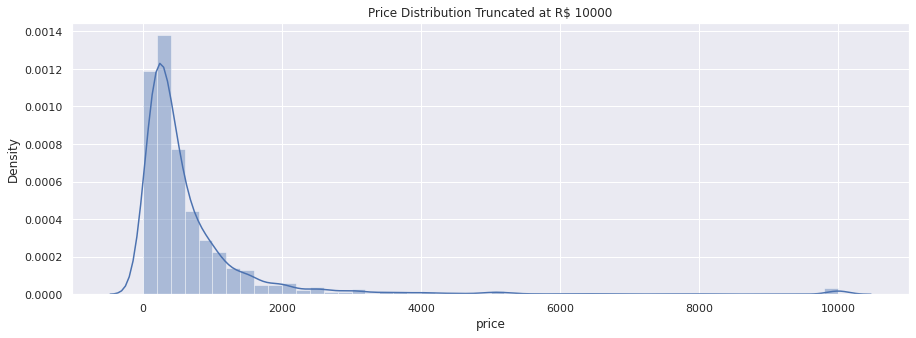

In [ ]:
plt.figure(figsize=(15,5))
sns.distplot(listings.price.clip(upper=10000))
plt.title('Price Distribution Truncated at R$ 10000')

### Are all values reasonable?

In [ ]:
top_five_prices = listings.sort_values(by='price', ascending=False).head(5)

In [ ]:
top_five_prices[['price', 'price_text', 'neighbourhood_cleansed', 'property_type', 'room_type', 'accommodates', 'bathrooms_text', 'bedrooms', 'beds']]

,price,price_text,neighbourhood_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds
8293,593266.0,"$593,266.00",São Cristóvão,Shared room in house,Shared room,5,1 shared bath,1.0,4.0
18759,129405.0,"$129,405.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
18991,126927.0,"$126,927.00",Copacabana,Entire apartment,Entire home/apt,3,1 bath,1.0,2.0
23477,126505.0,"$126,505.00",Guaratiba,Entire house,Entire home/apt,16,11 baths,11.0,11.0
23698,126505.0,"$126,505.00",Alto da Boa Vista,Entire house,Entire home/apt,8,2.5 baths,4.0,4.0


There seems to be some some prices wrongly assigned in the listings. First we will shed some light into this problem and propose some simple solutions.

  
The prices itself are not a good measure of the listing prices, a more meaningful measure would be prices by total are such as $m^2$. However, we do not have the listing area to compute such metric but we could use some proxies to the listing size such as: *accomodates*, *bedrooms*

In [ ]:
listings['price_per_person'] = listings['price'].div(listings['accommodates'])


- price_per_person for top 5 prices

In [ ]:
listings.loc[top_five_prices.index, ['price_per_person', 'price', 'price_text',
                                     'neighbourhood_cleansed', 'property_type', 
                                     'room_type', 'accommodates',
                                     'bathrooms_text', 'bedrooms', 'beds']]

,price_per_person,price,price_text,neighbourhood_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds
8293,118653.2000,593266.0,"$593,266.00",São Cristóvão,Shared room in house,Shared room,5,1 shared bath,1.0,4.0
18759,64702.5000,129405.0,"$129,405.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
18991,42309.0000,126927.0,"$126,927.00",Copacabana,Entire apartment,Entire home/apt,3,1 bath,1.0,2.0
23477,7906.5625,126505.0,"$126,505.00",Guaratiba,Entire house,Entire home/apt,16,11 baths,11.0,11.0
23698,15813.1250,126505.0,"$126,505.00",Alto da Boa Vista,Entire house,Entire home/apt,8,2.5 baths,4.0,4.0


-  Larger price_per_person prices

In [ ]:
listings.sort_values(by='price_per_person', ascending=False).head(5)[
                                    ['price_per_person', 'price', 'price_text',
                                     'neighbourhood_cleansed', 'property_type', 
                                     'room_type', 'accommodates',
                                     'bathrooms_text', 'bedrooms', 'beds']]

,price_per_person,price,price_text,neighbourhood_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds
8293,118653.2,593266.0,"$593,266.00",São Cristóvão,Shared room in house,Shared room,5,1 shared bath,1.0,4.0
18759,64702.5,129405.0,"$129,405.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
18760,63116.5,126233.0,"$126,233.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
18676,63116.5,126233.0,"$126,233.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
18758,63116.5,126233.0,"$126,233.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0


If we look at *price_per_person* we can see that we still have so high values for our initial top_five_prices, though the Guaratiba listing doesn't seem like such an anomalie. When contrasting these values with the higher *price_per_person* values we do have some unresonable values.

The first check we can perform is to compare the above prices witht their median prices by neighboorhood or by # badrooms (as the median is less susceptible to outliers than the mean) or a trimmed mean:

In [ ]:
listings.price_per_person.quantile(0.5)

110.0

In [ ]:
#Q1-1.5(Q3-Q1)
listings_nh_stats = (listings.groupby('neighbourhood_cleansed')
                             .agg(q50=('price_per_person', lambda x: x.quantile(0.5)),
                                  q95=('price_per_person', lambda x: x.quantile(0.95)),
                                  tukey_lower=('price_per_person', lambda x: x.quantile(0.25) - (x.quantile(0.75) - x.quantile(0.25)) * 1.25),
                                  tukey_upper=('price_per_person', lambda x: x.quantile(0.75) + (x.quantile(0.75) - x.quantile(0.25)) * 1.25),
                                  )
                             )

In [ ]:
listings_nh_stats.head()

,q50,q95,tukey_lower,tukey_upper
neighbourhood_cleansed,,,,
Abolição,64.500000,177.066667,-118.452381,273.214286
Acari,50.000000,50.000000,50.000000,50.000000
Alto da Boa Vista,192.187500,1376.910000,-148.513021,509.523437
Anchieta,432.950000,462.605000,375.287500,490.612500
Andaraí,86.083333,637.190000,-94.708333,311.875000


In [ ]:
(listings.loc[top_five_prices.index]
         .merge(listings_nh_stats.reset_index(), 
                on='neighbourhood_cleansed')
         .loc[:, ['price_per_person', 
                  'q50',	'q95',	'tukey_lower',
                  'tukey_upper', 'price', 'price_text',
                  'neighbourhood_cleansed', 'property_type', 
                  'room_type', 'accommodates',
                  'bathrooms_text', 'bedrooms', 'beds']])

,price_per_person,q50,q95,tukey_lower,tukey_upper,price,price_text,neighbourhood_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds
0,118653.2000,75.000000,475.066667,-53.750000,236.750000,593266.0,"$593,266.00",São Cristóvão,Shared room in house,Shared room,5,1 shared bath,1.0,4.0
1,64702.5000,109.000000,423.308333,-59.968750,303.943750,129405.0,"$129,405.00",Copacabana,Private room in bed and breakfast,Private room,2,1 bath,1.0,1.0
2,42309.0000,109.000000,423.308333,-59.968750,303.943750,126927.0,"$126,927.00",Copacabana,Entire apartment,Entire home/apt,3,1 bath,1.0,2.0
3,7906.5625,83.333333,1097.925000,-91.875000,284.375000,126505.0,"$126,505.00",Guaratiba,Entire house,Entire home/apt,16,11 baths,11.0,11.0
4,15813.1250,192.187500,1376.910000,-148.513021,509.523437,126505.0,"$126,505.00",Alto da Boa Vista,Entire house,Entire home/apt,8,2.5 baths,4.0,4.0


In [ ]:
listings.shape

(25784, 76)

It is clear that these cases can be treatet as outliers according to tukeys fence upper bound $Q3 + 1.5 * IQR$

We can try to fix or impute these values, though we must be careful to avoid data leakage. That is, if we use mean imputation or median for instance using the whole dataset we might shift the target distribution in this direction.  
  

One solution is to perform this adjustment with quantiles computed in a training dataset and use this values in a validation/hold-out ones. Proceeding in this fashion we would have to create a transfomer to use into our data preprocessing pipeline.

Another simpler solution can be to just remove these observations if we there are few data points to remove when contrasted to all observations. Let's analyse this solution:
  

In [ ]:
listings.shape

(25784, 76)

In [ ]:
out_shape = (listings.merge(listings_nh_stats.reset_index(), 
                            on='neighbourhood_cleansed')
                      .loc[:, ['price_per_person', 
                                'q50',	'q95',	'tukey_lower',
                                'tukey_upper', 'price', 'price_text',
                                'neighbourhood_cleansed', 'property_type', 
                                'room_type', 'accommodates',
                                'bathrooms_text', 'bedrooms', 'beds']]
                      .assign(outliers=lambda col: col['price_per_person'].lt(col['tukey_lower'])  | col['price_per_person'].gt(col['tukey_upper']))
                      .query('outliers == True')
                      .shape
                
 )

In [ ]:
'Fraction of outliers: {:,.2%}'.format(out_shape[0] / listings.shape[0])

'Fraction of outliers: 9.14%'

In [ ]:
Markdown("""
For a preliminary analysis **{:,.2%}** of lost data poins seems a small price to pay in contrast to the simpler preprocessing structure
""".format(out_shape[0] / listings.shape[0]))


For a preliminary analysis **9.14%** of lost data poins seems a small price to pay in contrast to the simpler preprocessing structure


In [ ]:
listings_tukey = (listings.merge(listings_nh_stats.reset_index(), 
                                on='neighbourhood_cleansed')
                          .assign(outliers=lambda col: col['price_per_person'].lt(col['tukey_lower'])  |
                                                       col['price_per_person'].gt(col['tukey_upper']))
                          .query('outliers == False')
                                              
 )


In [ ]:
listings_tukey[['price_per_person', 
                'q50',	'q95',	'tukey_lower',
                'tukey_upper', 'price', 'price_text',
                'neighbourhood_cleansed', 'property_type', 
                'room_type', 'accommodates',
                'bathrooms_text', 'bedrooms', 'beds']].head(3)

,price_per_person,q50,q95,tukey_lower,tukey_upper,price,price_text,neighbourhood_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds
0,100.0,109.0,423.308333,-59.96875,303.94375,500.0,$500.00,Copacabana,Entire condominium,Entire home/apt,5,1 bath,2.0,2.0
1,80.0,109.0,423.308333,-59.96875,303.94375,160.0,$160.00,Copacabana,Entire apartment,Entire home/apt,2,1 bath,1.0,2.0
2,78.5,109.0,423.308333,-59.96875,303.94375,157.0,$157.00,Copacabana,Entire loft,Entire home/apt,2,1 bath,1.0,1.0


### Do host with more listings have a higher average price?

To answear this question I'll be focusing on the price_per_person variable:

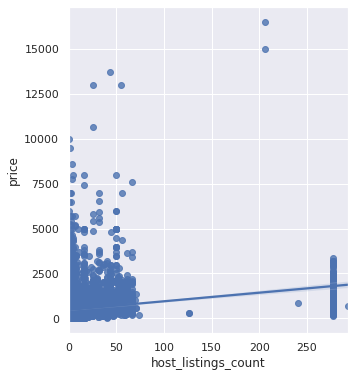

In [ ]:
f, ax = plt.subplots(figsize=(5, 6))

sns.regplot(data=listings_tukey, y='price', x='host_listings_count', ax=ax)

In [ ]:
listings_tukey[['price', 'host_listings_count']].corr()

,price,host_listings_count
price,1.00000,0.21087
host_listings_count,0.21087,1.00000


The low coeifficcient of correlation confirms the general sensus that should be no positive relation (nor negative) between prices and number of listings

### Check if these variables affect price:

The list of variables to check the relation is extensive, for numerical variables we could plot the scatterplot as we did before or more sistematically the correlation matrix 
  

For Categorical variables we could rely on some graphical resources though an One-way anova should do the trick.

First we will compute the number of bathrooms and afterwards some ratios:
- #bathrooms / accommodates
- #beds / accommodates
- #bedrooms / accomodates

In [ ]:
baths = listings_tukey['bathrooms_text'].value_counts().to_frame()

In [ ]:
baths['n_baths'] = baths.index.str.extract('([0-9\.]{1,3}[0-9]?)').values

In [ ]:
baths.query('n_baths!=n_baths')

,bathrooms_text,n_baths
Shared half-bath,12,NaN
Half-bath,7,NaN
Private half-bath,1,NaN


In [ ]:
baths.loc[baths.query('n_baths!=n_baths').index, 'n_baths'] = 0.5

In [ ]:
listings_tukey['n_baths'] = listings_tukey['bathrooms_text'].map(baths['n_baths'].to_dict()).astype(float)

In [ ]:

listings_tukey['n_baths'].dtype

dtype('float64')

In [ ]:
listings_tukey = listings_tukey.assign(
        baths_acc=lambda col: col['n_baths'].div(col['accommodates']),
        beds_acc=lambda col: col['beds'].div(col['accommodates']),
        bedrooms_acc=lambda col: col['bedrooms'].div(col['accommodates']),
)


I'll do a small sketch of how the analysis for categorical data can follow:

Due to the high cardinality of property type we can collapse its values to make visualization and comparisons easier

In [ ]:
keep_index = (listings_tukey.loc[:, 'property_type']
                            .value_counts(normalize=True)
                            .cumsum()
                            .to_frame()
                            .query('property_type < 0.9' ))
keep_index

,property_type
Entire apartment,0.572758
Private room in apartment,0.732488
Entire condominium,0.781790
Private room in house,0.830922
Entire house,0.870193
Entire serviced apartment,0.893029


In [ ]:
listings_tukey['property_type_collapsed'] = listings_tukey['property_type'] 

In [ ]:
mask_other = ~ listings_tukey['property_type_collapsed'].isin(keep_index.index)

In [ ]:
listings_tukey.loc[mask_other, 'property_type_collapsed']  = 'Others'

In [ ]:
order_idx = (listings_tukey.groupby(['property_type_collapsed'])
                           ['price']
                           .mean()
                          .sort_values(ascending=False)
                          .index);

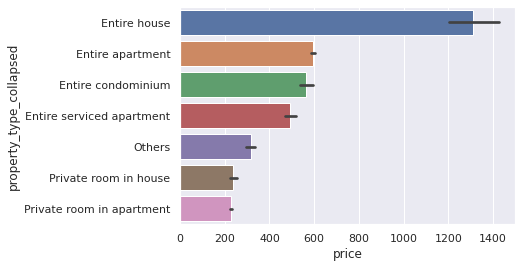

In [ ]:
sns.barplot(x='price', y='property_type_collapsed', data=listings_tukey, order=order_idx, orient='h')

We can see that there are signifficant differences in prices between categories even though we are using a measure of price per person! Here I use al loose visual inspection to afirm that the differences are significant, though a one way anova could be used to test if their difference is statistically different from 0. 

In [ ]:
lm = ols('price ~ property_type_collapsed', data=listings_tukey).fit()
table  = sm.stats.anova_lm(lm)

In [ ]:
table

,df,sum_sq,mean_sq,F,PR(>F)
property_type_collapsed,6.0,1.168534e+09,1.947556e+08,642.22108,0.0
Residual,23420.0,7.102190e+09,3.032532e+05,NaN,NaN


The null hypothesis of the test is that the two or  more groups have the same population mean and the low *p-value* implies that we can safely reject it. That is, the means are different, meaning that we can use this feature to explain  our target variable.

Now shall we repeat these reasoning for all relevant explanatory variables:

In [ ]:
features = [
  'n_baths',
  'baths_acc',
  'beds_acc',
  'bedrooms_acc',
  'property_type',
  'room_type',
  'host_has_profile_pic',
  'host_identity_verified',
  'host_verifications',
  'accommodates',
  'amenities',
  'minimum_nights',
  'maximum_nights',
  'minimum_minimum_nights',
  'maximum_minimum_nights',
  'minimum_maximum_nights',
  'maximum_maximum_nights',
  'minimum_nights_avg_ntm',
  'maximum_nights_avg_ntm',
  'calculated_host_listings_count',
  'calculated_host_listings_count_entire_homes',
  'calculated_host_listings_count_private_rooms',
  'calculated_host_listings_count_shared_rooms',
  'reviews_per_month',
  'has_availability',
  'availability_30',
  'availability_60',
  'availability_90',
  'availability_365']

- Numerical variables

In [ ]:
corr = listings_tukey[['price'] + features].select_dtypes('number').corr()

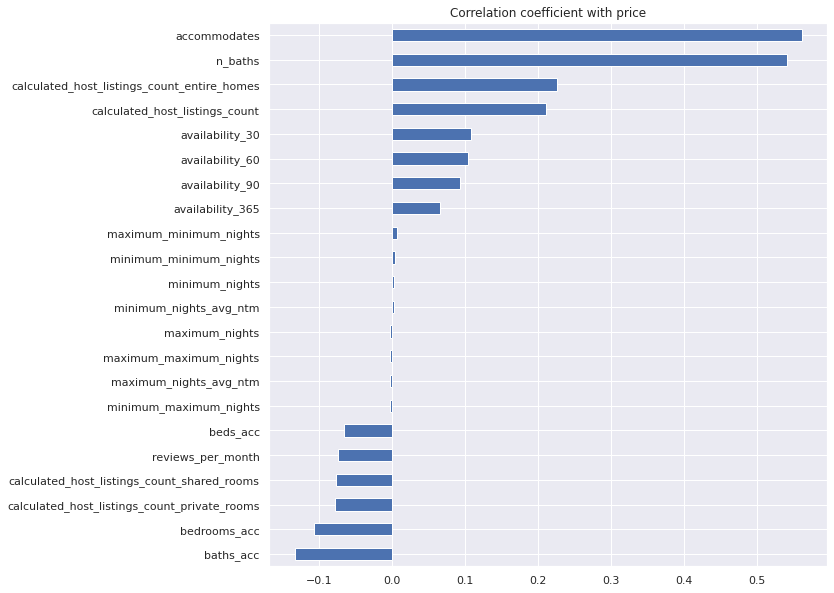

In [ ]:
plt.figure(figsize=(10, 10))
corr['price'].drop('price').sort_values().plot(kind='barh', title='Correlation coefficient with price');

The plot depicts some remarkable features:
1. **n_baths** is highly relevant as previously hypothesized
2. **baths_acc** negatively impact the price. This might be explained by the fact that people usually review more often when they have a bad review to make when contrasted to a positive one!

Another interesting thing to do is to compute correlation among feature that might be removable as highly correlated and possibl leading to multicollinearity!

In [ ]:
corr = listings_tukey[features].select_dtypes('number').corr()

In [ ]:
mask = np.triu(np.ones_like(corr, dtype=bool))

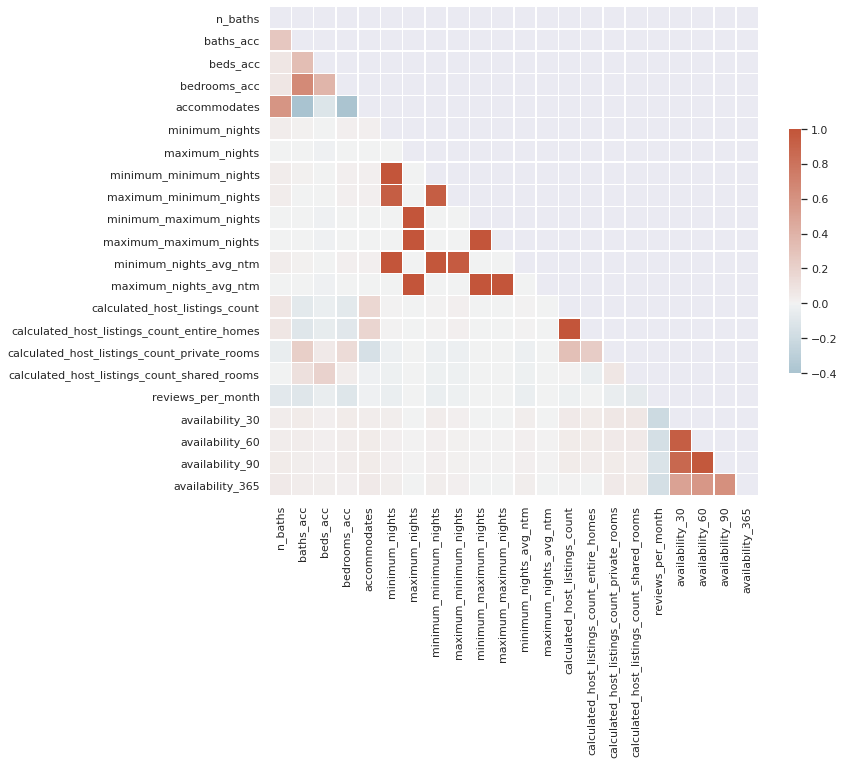

In [ ]:
f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

In [ ]:
# Select upper triangle of correlation matrix
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))

In [ ]:
# Find features with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

- Categorical

In [ ]:
listings_tukey[features].select_dtypes(exclude='number').head()

,property_type,room_type,host_has_profile_pic,host_identity_verified,host_verifications,amenities,has_availability
0,Entire condominium,Entire home/apt,t,t,"['email', 'phone', 'reviews', 'jumio', 'offlin...","[""Hot water"", ""Essentials"", ""Stove"", ""Microwav...",t
1,Entire apartment,Entire home/apt,t,f,"['phone', 'reviews', 'jumio', 'offline_governm...","[""TV"", ""Cable TV"", ""Elevator"", ""Essentials"", ""...",t
2,Entire loft,Entire home/apt,t,t,"['email', 'phone', 'reviews', 'jumio', 'govern...","[""Elevator"", ""Microwave"", ""Essentials"", ""Stove...",t
3,Entire apartment,Entire home/apt,t,t,"['email', 'phone', 'reviews', 'jumio', 'offlin...","[""Cable TV"", ""Elevator"", ""Air conditioning"", ""...",t
4,Entire apartment,Entire home/apt,t,t,"['email', 'phone', 'facebook', 'reviews', 'jum...","[""TV"", ""Cable TV"", ""Elevator"", ""Air conditioni...",t


In [ ]:
listings_tukey.groupby('room_type')['price'].mean()

room_type
Entire home/apt    624.115584
Hotel room         292.896907
Private room       235.028542
Shared room        178.310092
Name: price, dtype: float64

In [ ]:
lm = ols('price ~ property_type + room_type + host_has_profile_pic + host_identity_verified + has_availability', data=listings_tukey).fit()
table  = sm.stats.anova_lm(lm)
table.loc[:, 'PR(>F)'].map('{:,.2%}'.format)

property_type              0.00%
room_type                 66.14%
host_has_profile_pic       7.46%
host_identity_verified    89.91%
has_availability           0.08%
Residual                    nan%
Name: PR(>F), dtype: object

On a conjoint analysis  we might not cosnider the variable **room_type** and **host_identity_verified**, though, due to interactions we might check them individually:

In [ ]:
cols = ['property_type', 'room_type', 'host_has_profile_pic',
        'host_identity_verified', 'has_availability']

In [ ]:
for col in cols:
  lm = ols(f'price_per_person ~ {col}', data=listings_tukey).fit()
  table  = sm.stats.anova_lm(lm)
  decision = 'The mean difference between groups is statistically significant' if table.loc[col, 'PR(>F)'] < 0.05 else 'The mean difference between groups is not statistically significant' 
  
  print('Column {}, F value: {}, P_value {:,.2%}, decision: {}'.format(
      col, table.loc[col, 'F'], table.loc[col, 'F'], decision))

Column property_type, F value: 13.10898601375409, P_value 1,310.90%, decision: The mean difference between groups is statistically significant
Column room_type, F value: 199.40744510500602, P_value 19,940.74%, decision: The mean difference between groups is statistically significant
Column host_has_profile_pic, F value: 3.657634960328053, P_value 365.76%, decision: The mean difference between groups is not statistically significant
Column host_identity_verified, F value: 3.1659225307717196, P_value 316.59%, decision: The mean difference between groups is not statistically significant
Column has_availability, F value: 39.95944452480241, P_value 3,995.94%, decision: The mean difference between groups is statistically significant


At this stage we have enough evidence to remove **host_has_profile_pic** and **host_identity_verified**

In [ ]:
to_drop.append('host_has_profile_pic')

In [ ]:
to_drop.append('host_identity_verified')

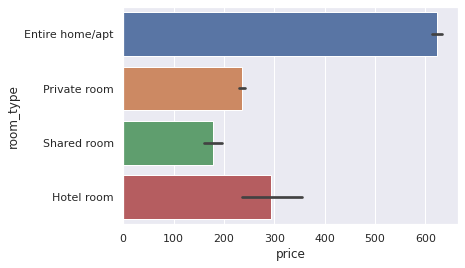

In [ ]:
sns.barplot(x='price', y='room_type', data=listings_tukey,  orient='h')

In [ ]:
lm = ols('''price ~  room_type ''', data=listings_tukey).fit()
table  = sm.stats.anova_lm(lm)
table.iloc[:, -1].map('{:,.2%}'.format)

room_type    0.00%
Residual      nan%
Name: PR(>F), dtype: object

We see that we have to treat features **host_verifications** and **amenities**

In [ ]:
listings_tukey['host_verifications'] = listings_tukey['host_verifications'].map(eval)

In [ ]:
listings_tukey['amenities'] = listings_tukey['amenities'].map(eval)

In [ ]:
listings_tukey[['host_verifications', 'amenities']].apply(lambda col: col.str.len(), axis=0).max()

host_verifications    11.0
amenities             69.0
dtype: float64

As the features have high cardinality one way to go is to compute the most frequent/infrequent values and create dummies for these variables

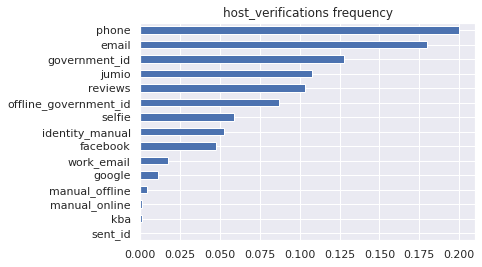

In [ ]:
(listings_tukey.loc[:, 'host_verifications']
               .explode()
               .value_counts(normalize=True, ascending=True)
               .plot(kind='barh', title='host_verifications frequency'));

In [ ]:
listings_tukey.id.nunique()

23427

In [ ]:
host_verifications_cols = (
    listings_tukey.set_index('id')
                  .loc[:, 'host_verifications']
                  .explode()
                  .pipe(pd.get_dummies, prefix='host_verifications')
                  .reset_index()
                  .groupby('id')
                  .sum()
                  )

In [ ]:
host_verifications_cols.reset_index().head()

,id,host_verifications_email,host_verifications_facebook,host_verifications_google,host_verifications_government_id,host_verifications_identity_manual,host_verifications_jumio,host_verifications_kba,host_verifications_manual_offline,host_verifications_manual_online,host_verifications_offline_government_id,host_verifications_phone,host_verifications_reviews,host_verifications_selfie,host_verifications_sent_id,host_verifications_work_email
0,17878,1,0,0,1,0,1,0,0,0,1,1,1,1,0,0
1,25026,0,0,0,1,0,1,0,0,0,1,1,1,0,0,0
2,35636,1,1,0,1,0,1,0,1,0,0,1,1,0,0,0
3,35764,1,0,0,1,0,1,0,0,0,0,1,1,0,0,0
4,41198,1,0,0,1,1,1,0,0,0,1,1,1,1,0,0


In [ ]:
(listings_tukey.loc[:, 'amenities']
               .explode()
               .nunique())

595

In [ ]:
relevant_amenities = (
    listings_tukey.loc[:, 'amenities']
                  .explode()
                  .value_counts(normalize=True, ascending=False)
                  .head(15)
                  
              
)

relevant_amenities.cumsum().map('{:,.2%}'.format)

Kitchen                   5.30%
Wifi                     10.50%
Essentials               15.50%
TV                       20.37%
Air conditioning         24.97%
Hangers                  29.04%
Iron                     32.90%
Washer                   36.58%
Elevator                 40.19%
Hot water                43.63%
Dedicated workspace      47.02%
Dishes and silverware    49.83%
Refrigerator             52.36%
Hair dryer               54.74%
Microwave                57.10%
Name: amenities, dtype: object

In [ ]:
relevant_amenities = (
    relevant_amenities.reset_index()
                      .rename(columns={'index': 'top_amenities'})
                      .loc[:, ['top_amenities']]
                      )

In [ ]:
amenities_cols = (
    listings_tukey.set_index('id')
                  .loc[:, 'amenities']
                  .explode()
                  .reset_index()
                  .merge(relevant_amenities, left_on='amenities', right_on='top_amenities')
                  .set_index('id')
                  .drop(columns='top_amenities')
                  .pipe(pd.get_dummies)
                  .reset_index()
                  .groupby('id')
                  .sum()
                  
             
)

amenities_cols.head()

,amenities_Air conditioning,amenities_Dedicated workspace,amenities_Dishes and silverware,amenities_Elevator,amenities_Essentials,amenities_Hair dryer,amenities_Hangers,amenities_Hot water,amenities_Iron,amenities_Kitchen,amenities_Microwave,amenities_Refrigerator,amenities_TV,amenities_Washer,amenities_Wifi
id,,,,,,,,,,,,,,,
17878,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1
25026,1,1,0,1,1,1,1,0,1,1,0,0,1,0,1
35636,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1
35764,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1
41198,1,0,0,1,0,0,0,0,0,1,0,0,0,0,1


In [ ]:
new_cols = pd.concat([host_verifications_cols, amenities_cols], axis=1).fillna(0)

In [ ]:
new_cols.columns = new_cols.columns.str.replace(' +', '_')

In [ ]:
listings_tukey = listings_tukey.merge(new_cols.reset_index())

In [ ]:
lm = ols('price ~ '+' + '.join([col for col in new_cols]), 
         data=listings_tukey).fit()
table  = sm.stats.anova_lm(lm)
table.head()

,df,sum_sq,mean_sq,F,PR(>F)
host_verifications_email,1.0,5.613951e+06,5.613951e+06,17.357842,3.107289e-05
host_verifications_facebook,1.0,1.154419e+06,1.154419e+06,3.569363,5.886724e-02
host_verifications_google,1.0,1.533979e+07,1.533979e+07,47.429276,5.846874e-12
host_verifications_government_id,1.0,4.187016e+06,4.187016e+06,12.945887,3.212865e-04
host_verifications_identity_manual,1.0,3.661226e+05,3.661226e+05,1.132019,2.873561e-01


In [ ]:
to_keep = (table.iloc[:, -1].to_frame()
                  .query('`PR(>F)` < 0.05')
                  .sort_values(by='PR(>F)')
                  .style
                  .format('{:,.2%}')
                  )
to_keep

,PR(>F)
amenities_Air_conditioning,0.00%
host_verifications_manual_online,0.00%
amenities_Washer,0.00%
amenities_Dishes_and_silverware,0.00%
amenities_TV,0.00%
amenities_Kitchen,0.00%
amenities_Hot_water,0.00%
amenities_Essentials,0.00%
host_verifications_work_email,0.00%
host_verifications_offline_government_id,0.00%


In [ ]:
features.extend(to_keep.index)

## calendar

In [ ]:
listings_tukey['last_scraped'] = pd.to_datetime(listings_tukey['last_scraped'])

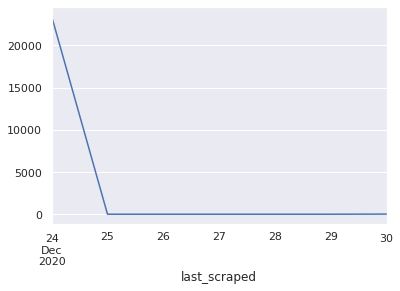

In [ ]:
listings_tukey.resample('D', on='last_scraped')['id'].count().plot()

In [ ]:
calendar['date'] = pd.to_datetime(calendar['date'])

In [ ]:
calendar['price'] = calendar['price'].str.replace('[\$,].', '').astype(float)

In [ ]:
calendar['adjusted_price'] = calendar['adjusted_price'].str.replace('[\$,].', '').astype(float)

In [ ]:
min_price = calendar.groupby('listing_id')['price'].min().rename('min_price')
max_price = calendar.groupby('listing_id')['price'].max().rename('max_price')

In [ ]:
non_flat_price =  (
    pd.concat([min_price, max_price], axis=1)
      .assign(non_constant_price=lambda col: 
              col['max_price'].ne(col['min_price']),
              delta=lambda col: col['max_price'] - col['min_price'])
              
      .query('non_constant_price==True')
      .sort_values(by='delta', ascending=False)
      )
non_flat_price.head()

,min_price,max_price,non_constant_price,delta
listing_id,,,,
13879989,70.0,7156.0,True,7086.0
43125106,0.0,4282.0,True,4282.0
137002,0.0,4282.0,True,4282.0
634088,0.0,4282.0,True,4282.0
43125556,1.0,4282.0,True,4281.0


In [ ]:
example_prices = calendar.merge(non_flat_price.head(5).index.to_frame().reset_index(drop=True))

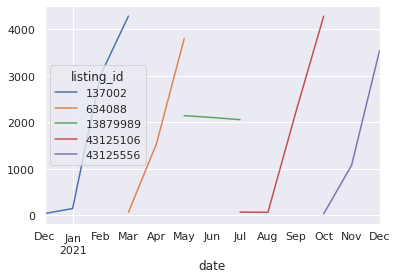

In [ ]:
example_prices.groupby('listing_id').resample('M', on='date')['price'].mean().unstack(0).plot();

We could use the previous price as an explanatory variable, though, as they vary little and might have a high first order autocorrelation it would be the single most important variable and we could model it as a ARIMA model for instance. 

Thus, for the sake of completeness I'll supress the price history and continue as this wasn't a relevant or available feature at prediction time. I'll retain only time invariant features and treat as a cross-section problem.

## Reviews

In [ ]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,17878,64852,2010-07-15,135370,Tia,This apartment is in a perfect location -- two...
1,17878,76744,2010-08-11,10206,Mimi,we had a really great experience staying in Ma...
2,17878,91074,2010-09-06,80253,Jan,Staying in Max appartment is like living in a ...
3,17878,137528,2010-11-12,230449,Orene,In general very good and reasonable price.\r\n...
4,17878,147594,2010-12-01,219338,David,The apt was nice and in a great location only ...


One interesting thing to consider is the comments text variable, that is, we can resort to some simple sentimet analysis to get a sense of positive and negative reviews. One quick way to achieve this is by extracting is by using vader sentiment analyzer:

In [ ]:
analyzer = SentimentIntensityAnalyzer()

In [ ]:
snt = analyzer.polarity_scores(reviews['comments'][0])

In [ ]:
snt = reviews['comments'].astype(str).apply(analyzer.polarity_scores)

In [ ]:
reviews = pd.concat([reviews, pd.DataFrame(snt.to_list())], axis=1)

In [ ]:
reviews['sentiment'] = 'neutral'
reviews.loc[reviews['comments'].isna(), 'sentiment'] = 'neutral'
reviews.loc[reviews['compound'].gt(0.05), 'sentiment'] = 'positive'
reviews.loc[reviews['compound'].lt(-0.05), 'sentiment'] = 'negative'

In [ ]:
reviews.head(2)

,listing_id,id,date,reviewer_id,reviewer_name,comments,neg,neu,pos,compound,sentiment
0,17878,64852,2010-07-15,135370,Tia,This apartment is in a perfect location -- two...,0.078,0.709,0.213,0.8976,positive
1,17878,76744,2010-08-11,10206,Mimi,we had a really great experience staying in Ma...,0.041,0.723,0.236,0.9297,positive


Now we can create some variables using the reviews:

In [ ]:
reviews['date'] = pd.to_datetime(reviews['date'])

In [ ]:
reviews_full = listings_tukey[['id', 'last_scraped']].merge(reviews, left_on='id', right_on='listing_id')

In [ ]:
avoid_leakage = reviews_full['last_scraped'].ge(reviews_full['date'])

In [ ]:
avoid_leakage.mean()

1.0

In [ ]:
sent_count = (reviews_full.sort_values(by=['listing_id', 'date'])
                          .groupby('listing_id')
                          ['sentiment']
                          .value_counts())

In [ ]:
sent_count_lag = (
     reviews_full.sort_values(by=['listing_id', 'date'])
                 .groupby('listing_id')
                 .tail(30)
                 .groupby('listing_id')
                 ['sentiment']
                 .value_counts()
                 .rename('sentiment_lag')
            )

In [ ]:
sent = pd.concat([sent_count, sent_count_lag], axis=1).unstack(1).fillna(0)

In [ ]:
sent['total_count'] = sent['sentiment'].sum(axis=1)

In [ ]:
sent['total_count_lag'] = sent['sentiment_lag'].sum(axis=1)

In [ ]:
sent['sentiment'] = sent['sentiment'].values * pd.concat([sent['total_count']**-1]*3, axis=1).values

In [ ]:
sent['sentiment_lag'] = sent['sentiment_lag'].values * pd.concat([sent['total_count_lag']**-1]*3, axis=1).values

In [ ]:
sent.head()

sentiment                      ... sentiment_lag total_count total_count_lag
sentiment   negative   neutral  positive  ...      positive                            
listing_id                                ...                                          
17878       0.081081  0.158301  0.760618  ...      0.633333       259.0            30.0
25026       0.063025  0.205882  0.731092  ...      0.366667       238.0            30.0
35636       0.049724  0.243094  0.707182  ...      0.600000       181.0            30.0
35764       0.109827  0.300578  0.589595  ...      0.166667       346.0            30.0
41198       0.055556  0.333333  0.611111  ...      0.611111        18.0            18.0

[5 rows x 8 columns]

In [ ]:
sent.columns = [index[0]+'_'+index[1] for index in sent.columns.values]

In [ ]:
listings_tukey = listings_tukey.merge(sent, left_on='id', right_index=True, how='left')

In [ ]:
listings_tukey[sent.columns] = listings_tukey[sent.columns].fillna(0)

In [ ]:
features.extend(sent.columns)

In [ ]:
corr = listings_tukey[['price'] + sent.columns.to_list()].corr()

In [ ]:
mask = np.triu(np.ones_like(corr, dtype=bool))


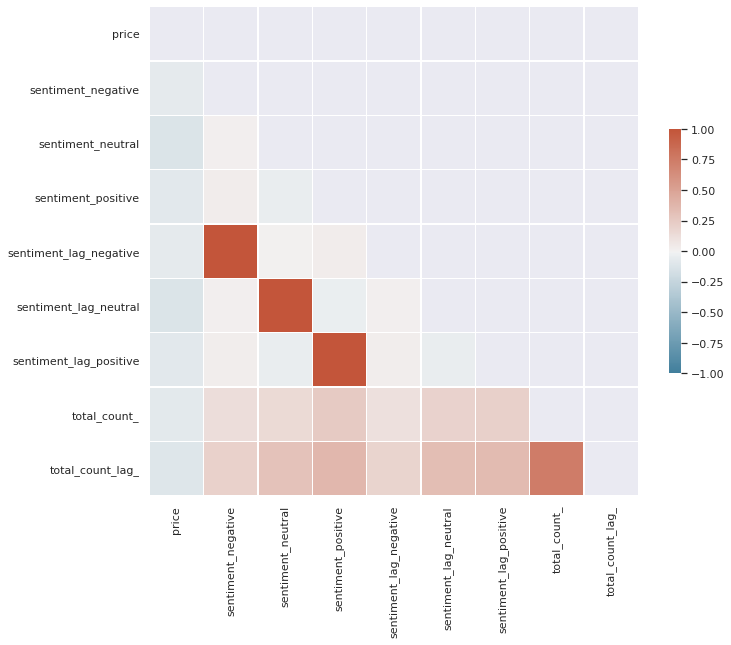

In [ ]:
f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0, vmin=-1,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

It seems there is no strongly correlated feature with our target.

In [ ]:
recent_sent = (reviews_full.sort_values(by=['listing_id', 'date'])
                           .groupby('listing_id')
                           ['sentiment']
                           .last()
                           .to_frame()
                            )

In [ ]:
listings_tukey = listings_tukey.merge(recent_sent, left_on='id', right_index=True, how='left')

In [ ]:
listings_tukey['sentiment'] = listings_tukey['sentiment'].fillna('neutral')

In [ ]:
lm = ols('price ~ sentiment', data=listings_tukey).fit()
table  = sm.stats.anova_lm(lm)
'p-val: {:,.2%}'.format(table.loc['sentiment', 'PR(>F)'])

'p-val: 0.00%'

In [ ]:
to_drop.append('sentiment')

The sentiment fatures weren't all helpful

## Neighbourhood

We are only going to keep the neighbourhoods_geoson dataset as the neighbourhoods is a subset of it

In [ ]:
assert neighbourhoods_geojson.merge(neighbourhoods, on = 'neighbourhood', how='left').shape[0] == neighbourhoods_geojson.shape[0]

In [ ]:
neighbourhoods = neighbourhoods_geojson

In [ ]:
del neighbourhoods_geojson

Lest make a map with the neighbourhoods:

In [ ]:
mapa = folium.Map(location=[-22.9035, -43.2096], zoom_start=11)
folium.GeoJson(data=neighbourhoods["geometry"]).add_to(mapa) 
mapa

This first map is really simple, just adding the polygons for neighbourhoods in RJ city. 
    
    
However, we can make better usage of this sort of information by checking wether there as spillover effects on prices over areas. That is, we can state the hypothesis that a rich neighborhood tends to be clustered (surrounded by) in a area with higher average listing prices, leading to wealthy vicinities, or conversely poorer ones. If this is said to be true we could devise a feature mapping the listing neighboorhood to the center of a poligon with the wealthier ones capturing how far it is from the richer area.
  
    
  
Another possiblity is to check the listing density, or amount of listings by neighbourhoods, this could give us a measure of the real state listing supply, we could expectd regions with more listings to be more competitive and have prices in a thicker range of values as they tend to be price takers.



We can start by validating the key column to map from the listings dataset to the neighbourhood one. Thus, we want to test if *neighbourhood_cleansed* from **listings** are included in all *neighbourhood* in **neighbourhoods**

In [ ]:
assert set(listings['neighbourhood_cleansed'].unique()).difference(neighbourhoods.neighbourhood) == set(), 'keys in listing not present in neighbourhoods'

### Heatmap of listings

Also it is useful to visualize the listings in the map:

In [ ]:
mapa = folium.Map(location=[-22.9035, -43.2096], zoom_start=11)
folium.GeoJson(data=neighbourhoods["geometry"]).add_to(mapa) 
mapa.add_child(plugins.HeatMap(listings_tukey[['latitude', 'longitude']].values,
                               radius=10))

We can see an area with general high density, for instance in neighbourhoods as: Copabana, Leblon 

### neighbourhood avgs

Lets visualize the overall neighbourhood price per person averages:

In [ ]:
neigh_avg  = listings_tukey.groupby('neighbourhood_cleansed')['price'].mean().rename('neighbourhood')

In [ ]:
cmap = linear.RdBu_05.colors
cmap.reverse()

colormap = LinearColormap(cmap).scale(neigh_avg.min(), neigh_avg.max())
color_dict = {key: colormap(neigh_avg[key]) for key in neigh_avg.keys()}

In [ ]:
no_case_neigh = neighbourhoods.set_index('neighbourhood').index.difference(listings_tukey['neighbourhood_cleansed'].unique()).to_list()

In [ ]:
no_case_neigh = {k: rgb2hex((1,1,1)) for k in no_case_neigh}

In [ ]:
color_dict.update(no_case_neigh)

In [ ]:
mapa = folium.Map(location=[-22.9035, -43.2096], zoom_start=11)
folium.GeoJson(data=neighbourhoods.set_index('neighbourhood'),
               name='Average price by neighbourhoods',
               style_function=lambda feature: {
                   'fillColor':color_dict[feature['id']],
                   'weight':1,
                   'fillOpacity':0.9
               }
               ).add_to(mapa)
colormap.caption = 'Average price by neighbourhoods' 
colormap.add_to(mapa)
folium.LayerControl(collapsed=False).add_to(mapa)
mapa


Another possiblity is to check the listing density, or amount of listings by neighbourhoods, this could give us a measure of the real state listing supply, we could expectd regions with more listings to be more competitive and have prices in a thicker range of values as they tend to be price takers.

If we check the average values by neighbourhood we realize that the areas with high density (heatmap) do tend to have moderate prices due to high supply even though they are on areas with high $\frac{price}{m^2}$ (real state prices).

### Spillover
We can try to visualize the spillover effect

In [ ]:
cmap = linear.RdBu_05.colors
cmap.reverse()

colormap = LinearColormap(cmap).scale(listings_tukey.price.min(),
                                      listings_tukey.price.quantile(.75))

In [ ]:
plot_data = listings_tukey[['latitude', 'longitude', 'price']]

In [ ]:
plot_data['color'] = plot_data['price'].map(colormap)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
mapa = folium.Map(location=[-22.9035, -43.2096], zoom_start=11)
folium.GeoJson(data=neighbourhoods["geometry"]).add_to(mapa) 

for _, data in plot_data.iterrows():
  folium.CircleMarker(
      location=data[['latitude', 'longitude']].to_list(),
      color=data['color'],
      radius=5
      
  ).add_to(mapa)

colormap.caption = 'Average price by neighbourhoods' 
colormap.add_to(mapa)
folium.LayerControl(collapsed=False).add_to(mapa)
mapa

We doo see some clustering on the map near the ocean, though, even in these areas we have listings with reasonable prices. We could explore more the data but due to time constraints I'll disconsider the spatial notion from the features to predict the price.

#  Price modelling

In [ ]:
to_drop.append('host_verifications')

In [ ]:
to_drop.append('amenities')

In [ ]:
features = list(set(features).difference(to_drop))

In [351]:
df.columns.to_list()

['price',
 'calculated_host_listings_count',
 'host_verifications_email',
 'host_verifications_jumio',
 'amenities_Washer',
 'amenities_Kitchen',
 'baths_acc',
 'accommodates',
 'amenities_Wifi',
 'beds_acc',
 'amenities_Iron',
 'reviews_per_month',
 'amenities_Hair_dryer',
 'host_verifications_kba',
 'total_count_lag_',
 'host_verifications_selfie',
 'availability_365',
 'sentiment_lag_neutral',
 'bedrooms_acc',
 'minimum_nights',
 'amenities_Essentials',
 'host_verifications_google',
 'host_verifications_government_id',
 'amenities_TV',
 'host_verifications_work_email',
 'host_verifications_sent_id',
 'maximum_nights',
 'sentiment_negative',
 'calculated_host_listings_count_private_rooms',
 'total_count_',
 'sentiment_neutral',
 'calculated_host_listings_count_shared_rooms',
 'host_verifications_offline_government_id',
 'amenities_Hot_water',
 'sentiment_lag_negative',
 'amenities_Microwave',
 'maximum_minimum_nights',
 'host_verifications_manual_online',
 'n_baths',
 'availability_3

In [ ]:
df = listings_tukey[['price'] + features]

In [225]:
df['price'] = df['price'].clip(lower=df['price'].quantile(0.1))

## Categorial Encoding

In [226]:
df = pd.get_dummies(df)

In a real modelling scenario we shouldn't extract dummie variables on the whole dataset, actually we might use only the training one to avoid biases when evaulating the model peformance on the validation/hold-out data. To keep things simpler I'll use the whole dataset bearing in mind the biases on my metrics.

## Evaluation Strategy

In [227]:
X = df.drop(columns='price')

In [228]:
y = df[['price']]

In [229]:
x_train, x_hold, y_train, y_hold = train_test_split(X, y, test_size=0.2)

In [230]:
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=0.25)

In [231]:
x_train.shape[0]/X.shape[0]

0.5999487770521194

In [232]:
x_test.shape[0]/X.shape[0]

0.20002561147394032

In [233]:
x_hold.shape[0]/X.shape[0]

0.20002561147394032

Utilizaremos o deviance residual assumindo uma distribuição gamma já que os preços são extritamente positivos e não queremos predições negativas!

## Dummy model

In [234]:
dummy = DummyRegressor()

In [235]:
dummy.fit(x_train, y_train)

DummyRegressor()

In [249]:
y_pred_train = dummy.predict(x_train[reduced_model])
y_pred_test = dummy.predict(x_test[reduced_model])
y_pred_hold = dummy.predict(x_hold[reduced_model])

In [250]:
mean_gamma_deviance(y_train, y_pred_train)

0.7437995700539896

In [251]:
mean_gamma_deviance(y_test, y_pred_test)

0.708120769076693

In [252]:
mean_gamma_deviance(y_hold, y_pred_hold)

0.7317022251506347

## Baseline model

Here we'll fit a simple gamma regressor with just a few covariates:

In [240]:
reduced_model = ['accommodates','n_baths','baths_acc', 'bedrooms_acc']

In [241]:
reduced_model.extend([col for col in x_train if col.startswith('room_type')])

In [287]:
gamma = GammaRegressor(alpha=0)

In [288]:
imputer = SimpleImputer(strategy='median')

In [289]:
pipe = make_pipeline(imputer, gamma)

In [290]:
pipe.fit(X=x_train[reduced_model], y=y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='median')),
                ('gammaregressor', GammaRegressor(alpha=0))])

In [291]:
y_pred_train = pipe.predict(x_train[reduced_model])
y_pred_test = pipe.predict(x_test[reduced_model])
y_pred_hold = pipe.predict(x_hold[reduced_model])

In [292]:
mean_gamma_deviance(y_train, y_pred_train)

0.36126528162708227

In [293]:
mean_gamma_deviance(y_test, y_pred_test)

0.3465313660690797

In [294]:
mean_gamma_deviance(y_hold, y_pred_hold)

0.34770343288808314

## Gamma with grid search

In [398]:
gamma = GammaRegressor(max_iter=int(1e6), alpha=0.1)
imputer = SimpleImputer(strategy='median')
scaling = StandardScaler()
pipe = make_pipeline(imputer,scaling, gamma)



In [382]:
np.random.seed(123)

In [399]:
pipe.fit(x_train, y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='median')),
                ('standardscaler', StandardScaler()),
                ('gammaregressor',
                 GammaRegressor(alpha=0.1, max_iter=1000000))])

In [400]:
y_pred_train = pipe.predict(x_train)
y_pred_test = pipe.predict(x_test)
y_pred_hold = pipe.predict(x_hold)

In [401]:
mean_gamma_deviance(y_train, y_pred_train)

0.2972551782736117

In [402]:
mean_gamma_deviance(y_test, y_pred_test)

0.29819040051105206

In [403]:
mean_gamma_deviance(y_hold, y_pred_hold)

0.2947939119170594

## LGBM

In [436]:
lgbm = LGBMRegressor(objective='gamma', n_estimators=100, max_depth=4)

In [437]:
lgbm.fit(x_train, y_train)

LGBMRegressor(max_depth=4, objective='gamma')

In [438]:
mean_gamma_deviance(y_train, lgbm.predict(x_train))

0.22845851044900115

In [439]:
mean_gamma_deviance(y_test, lgbm.predict(x_test))

0.25490221319133827

In [440]:
mean_gamma_deviance(y_hold, lgbm.predict(x_hold))

0.24752610792622426

If we compare the test set gamma deviance scores we can safely choose the bosting model (LGBM)

# Modelling diagnosis

In [444]:
y_train_pred = lgbm.predict(x_train)
y_test_pred = lgbm.predict(x_test)
y_hold_pred = lgbm.predict(x_hold)

- Deviance

In [449]:
mean_gamma_deviance(y_hold, y_hold_pred)

0.24752610792622426

- Percentual error 

In [454]:
mean_absolute_percentage_error(y_hold, y_hold_pred)

0.4835822798027145

- root mse

In [458]:
np.sqrt(mean_squared_error(y_hold, y_hold_pred))

382.87510598928225

- Atual vs predicted:

In [473]:
import matplotlib.lines as mlines
import matplotlib.transforms as mtransforms

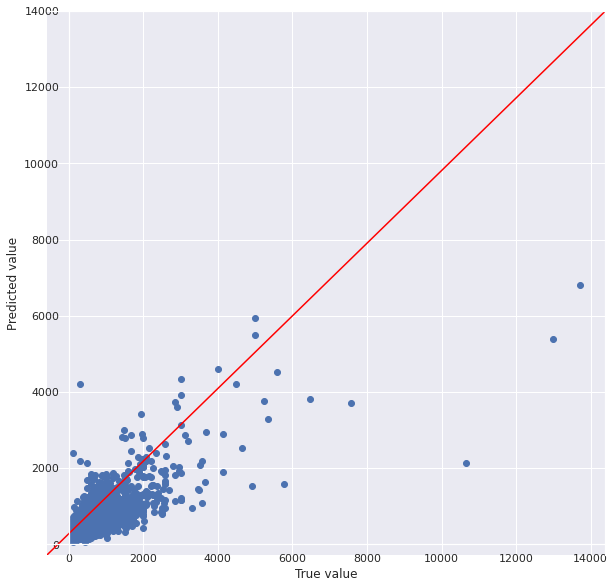

In [493]:
fig, ax = plt.subplots(figsize=(10,10))
ax.scatter(y_hold, y_hold_pred)
# xtickslocs = ax.get_xticks()
# ax.set_yticks(xtickslocs)
ax.set_yticks(range(0, 16000, 2000))
ax.set_xticks(range(0, 16000, 2000))
# xticks(range(0, 16000, 2000))
ax.spines['left'].set_position('zero')
ax.spines['bottom'].set_position('zero')
plt.xlabel('True value')
plt.ylabel('Predicted value')
line = mlines.Line2D([0, 1], [0, 1], color='red')
transform = ax.transAxes
line.set_transform(transform)
ax.add_line(line)
plt.show()


- Predicted values - means

In [480]:
y_hold.mean()

price    520.786812
dtype: float64

In [481]:
 y_hold_pred.mean()

500.02886780387354

# Final thoughs.

The model has a high absolute percentual error, and an average error of \$382, which might be high for some values and lower for other ones. 
  
If we consider $E[price|covariates]$ we see that the model seems fairly well calibrated with the predicted mean close to the true average

IF we look at the scatterplot we see that the model performs poorly on high true values (might e outliers or leverage points)